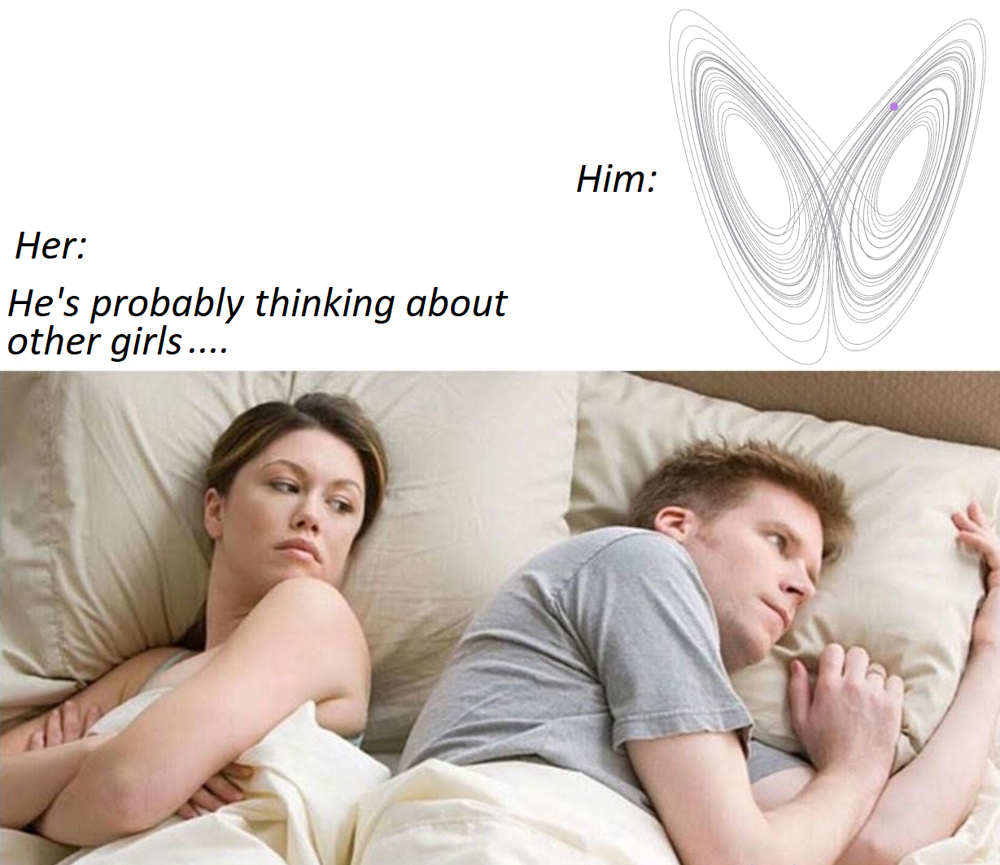

-------------------------

# $\textbf{CHAPTER 03}$ : Dynamical systems with dynamic programming.

--------------

## $\color{red}{\text{GOAL 1}}$ : Calculate $\Big($in linear time and space: $T(n)=S(n)=\Theta\big(n\big)\Big)$ the orbit: $$\big(f^n(x)\big)_{n\in\mathbb N}=\Big(x,f(x),f\big(f(x)\big)\dots f^n(x)\dots\Big),\text{ given $f$.}$$

--------------

## $\color{red}{\text{GOAL 2}}$ : Test the chaotic behavior of the logistic map: $f_{\lambda}(x)=\color{black}{\lambda} x(1-x).$

-------------

## $\color{red}{\text{GOAL 3}}$ : Let $\big(\mathbb R$, $f,\mu,\Sigma\big)$ be a topological dynamical system with : $f(x)=ax+b,$ $a\neq 1,$ calculate all the periodic points of the system in linear time.

----------------

In [306]:
#import some software
import sympy as sp
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from sympy import Symbol
from sympy import factor
from sympy.abc import a,b,x
%matplotlib inline
sp.init_printing()

In [185]:
#the logistic map:
l = Symbol('λ')
fl = lambda x: l*x*(1-x)

fl(x)

In [186]:
fl(1)==fl(0)==0

True

In [187]:
fl(1-1/l) #fixed point

In [188]:
fl(fl(1/l))

In [250]:
### Main(): 

class Dynamics:
    from sympy.abc import x
    
    def __init__(self,f,x):
        self.f = f
        self.x = x
    def __repr__(self):
        return f'{self.f(self.x)}'
    def __str__(self):
        return f'{self.f(self.x)}'
    def __add__(self,other):
        return self.f(self.x) + other.f(other.x)
    def __sub__ (self,other):
        return self.f(self.x) - other.f(other.x)
    def __mul__ (self,other):
        return self.f(self.x) * other.f(other.x)
    def __rmul__ (self,val):
        return val * self.f(self.x)
         
    ''' #Traditional way:
    
    def f_n(self,n):   # Input: f: function, n : iterations
        if n==0:
            return self.x
        elif n==1:
            return factor(self.f(self.x))
        return factor(self.f(f_n(self,n-1))) # exp time, 2slow :(
    '''
    #dynamic programming approach:
    def f_n(self,n=None): # f: function, n: iterations, linear time<3
        
        if n!=None:
            #main algorithm:
            if n==0:
                return self.x
            elif n==1:
                return factor(self.f(self.x))
    
            F = [self.f(self.x),self.f(self.f(self.x))]
            for i in range(2,n):
                F.append(self.f(F[i-1]))
            return F[-1]
        
        else:
            return self.f(self.x)
        
    def Orbit(self,n=None):
        O = [self.x,factor(self.f(self.x))]
            
        if n!=None:
            for i in range(2,n+1):
                O.append(factor(self.f_n(i)))
            return O
        else:
            return O


In [260]:
#real line d.s:
f = lambda x : a*x + b
f(x)

In [222]:
f(-b/a) 

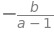

In [223]:
factor(f(- b/(a-1))) #fixed point

In [224]:
f_dyn = Dynamics(f,x)

f_dyn

a*x + b

In [225]:
#check the class:

2*f_dyn

In [226]:
factor(2*f_dyn)

In [227]:
1*f_dyn

In [228]:
1/(a*x+b)*f_dyn

In [229]:
f_dyn.f_n()

In [230]:
f_dyn.f_n(2)

In [231]:
factor(f_dyn.f_n(2)) #f^2(x)

In [232]:
factor(f_dyn.f_n(3)) #f^3(x)

In [233]:
factor(f_dyn.f_n(4)) #f^4(x)

In [234]:
f_dyn.Orbit(16) 

In [235]:
f_dyn.Orbit(16)[-1]

-------------------

$\bullet$ Έστω $f(x)=b-ax, a\neq -1,b\in\mathbb R$,
$$f^n(x)=a^n(-1)^nx+b\sum_{k=0}^{n-1}a^k(-1)^k=a^n(-1)^nx +\cfrac{b\big[ (-1)^{n+1}a^n+1\big]}{a+1},$$
$$\implies f^n(x)=x\iff x=\cfrac{b}{a+1}\in Fix(f^n)=Per_n(f).$$

---------------

In [243]:
f_new_dyn = Dynamics(f,-b/(a-1))

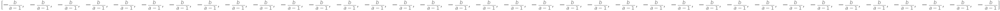

In [244]:
f_new_dyn.Orbit(35) #periodic orbit

In [317]:
g = lambda x: x+(1/2)+(1/97)*np.sin(2*np.pi*x) 
G_dyn = Dynamics(g,0)
G_dyn.Orbit(50) #periodic orbit.


In [289]:
#ploting the chaotic logistic map.

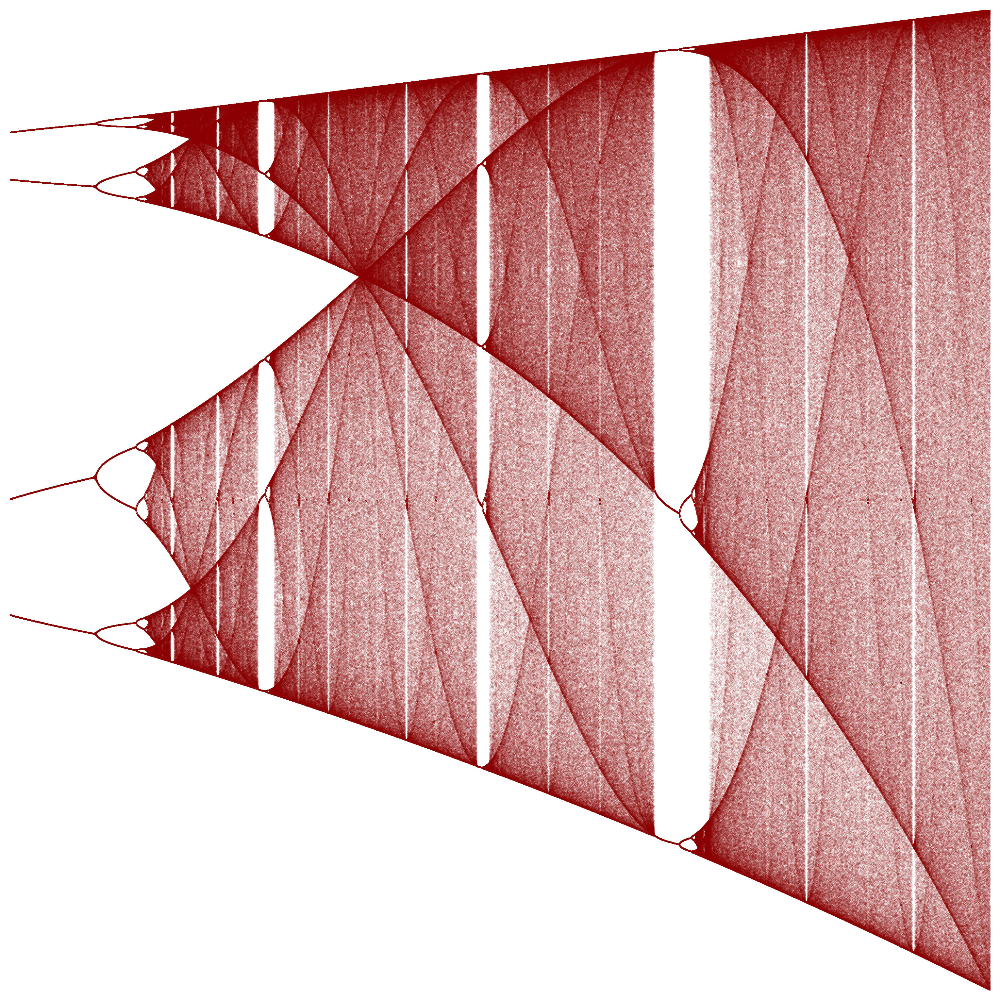

In [287]:
y_ini = 0.01 
x_min, x_max = [3.5, 4] 
y_min, y_max = [0, 1]
iters = 1500 #number of iterations, higher is more accurate and more computationally expensive



last = round(0.8*iters)
n_pixels = 3000
Zx = np.linspace(x_min, x_max, n_pixels)
y = np.repeat(y_ini, n_pixels)
for i in range(iters):
    y = Zx*y*(1-y)
    if i >= (iters-last): 
        if i == (iters-last): 
            D = np.array([Zx, y]).T
        else: D = np.concatenate([D,np.array([Zx, y]).T], axis = 0)            
X = D[:,0]
Y = D[:,1]

fig, ax = plt.subplots(figsize=(10, 10), 
                       dpi=300, 
                       facecolor='white', 
                       edgecolor='none'
                      )
plt.axis('off')
ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
plt.gca().set_axis_off()
plt.subplots_adjust(top = 1, bottom = 0, right = 1, left = 0, hspace = 0, wspace = 0)
plt.margins(0,0)
plt.gca().xaxis.set_major_locator(plt.NullLocator())
plt.gca().yaxis.set_major_locator(plt.NullLocator())

plt.scatter(X,Y, s = (3*72/n_pixels)**2, alpha = 0.8 ,c = 'darkred' ,marker = '.')
plt.show()

-------------------

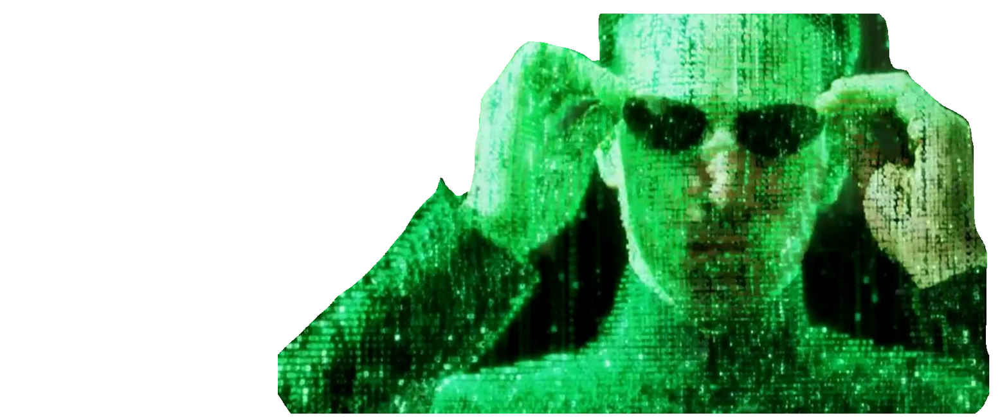